# Рекомендательная система книг

**Борисочкин Михаил ML-12**

## Задание

1. **Реализовать персональный топ  - принимает на вход возраст и локацию, на выходе персональный топ   - 1 балл** <br/> Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.
<br/><br/>
2. **На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 27) - 3 балла**<br/> Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.
<br/><br/>
3. **Совстречаемость - 3 балла**<br/>В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок.
<br/><br/>
4. **Коллаборативная фильтрация - 3 балла**<br/>Коллаборативную фильтрацию реализовывать как на слайде 51 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.<br/>Если совсем сложно - можно сделать как в семинарской части, поставив оценку "0", если рейтинг < 5 и "1" - в противном случае. Тогда максимум за это - 1 балл. Реализовать U2I и I2I рекомендации.
<br/><br/>

*Примечание:*

Так как пользователей много - можно зафиксировать несколько произвольных и для них уже составлять рекомендации

Работоспособность I2I можно проверять на известных книгах (Гарри Поттер, Властелин Колец, Интервью с вампиром, Код-Да-Винчи, Маленький Принц)

Рейтинг книг обязательно нужно учитывать

Не забываем также предобработать данные - выкинуть выбросы-пользователей и выбросы-книги.

Выводить в качестве рекомендаций лучше названия книг, картинки (если они есть) и соответствующие метрики близости.

In [252]:
from io import BytesIO
from PIL import Image
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import DBSCAN
from sklearn.metrics.pairwise import cosine_similarity
from scipy.sparse import coo_matrix, csr_matrix

import numpy as np
import pandas as pd
import requests
import tqdm
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_style("ticks")

## Загрузка и предобработка данных

In [2]:
# Загрузка данных о пользователях, книгах и рейтингах книг
users = pd.read_csv("data/BX-Users.csv.gz", sep=";", encoding="ISO-8859-1")
books = pd.read_csv("data/BX-Books.csv.gz", low_memory=False)
interactions = pd.read_csv(
    "data/BX-Book-Ratings.csv.gz", sep=";", encoding="ISO-8859-1"
)

In [3]:
# Содержимое набора данных users
users.sample(10, random_state=42)

,User-ID,Location,Age
246667,246668,"porto, n/a, portugal",22.0
112812,112813,"atlanta, georgia, usa",54.0
117301,117302,"tallahassee, florida, usa",34.0
272315,272316,"talavera de la reina, toledo, spain",19.0
237932,237933,"hopewell, virginia, usa",39.0
170595,170596,"kyle, texas, usa",28.0
194536,194537,"sanming, fujian, china",NaN
204505,204506,"kingston, ontario, canada",24.0
209655,209656,"coupeville, washington, usa",61.0
79087,79088,"santa cruz do rio pardo, são paulo, brazil",19.0


In [4]:
# Содержимое набора данных books
books.sample(10, random_state=42)

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
103740,0679764275,The F Word,Jesse Sheidlower,1995,Random House Reference Publishing,http://images.amazon.com/images/P/0679764275.0...,http://images.amazon.com/images/P/0679764275.0...,http://images.amazon.com/images/P/0679764275.0...
195299,3257228589,Davids Rache.,Hans Werner Kettenbach,1996,Diogenes Verlag,http://images.amazon.com/images/P/3257228589.0...,http://images.amazon.com/images/P/3257228589.0...,http://images.amazon.com/images/P/3257228589.0...
161791,0812577647,Sky Knife,Marella Sands,2000,Tor Books,http://images.amazon.com/images/P/0812577647.0...,http://images.amazon.com/images/P/0812577647.0...,http://images.amazon.com/images/P/0812577647.0...
184788,0156372118,The Groves of Academe,Mary McCarthy,1992,Harcourt,http://images.amazon.com/images/P/0156372118.0...,http://images.amazon.com/images/P/0156372118.0...,http://images.amazon.com/images/P/0156372118.0...
161347,0590470485,Karen's Lucky Penny (Baby-Sitters Little Siste...,Ann M. Martin,1994,Scholastic,http://images.amazon.com/images/P/0590470485.0...,http://images.amazon.com/images/P/0590470485.0...,http://images.amazon.com/images/P/0590470485.0...
73355,0671571575,"Game Of Chance (Silhouette Romance, #157)",Donna Vitek,1982,Silhouette Books,http://images.amazon.com/images/P/0671571575.0...,http://images.amazon.com/images/P/0671571575.0...,http://images.amazon.com/images/P/0671571575.0...
154424,0030494702,The Teaching of Reverence for Life.,"Albert, Schweitzer",1965,"Henry Holt &amp; Company, Inc.",http://images.amazon.com/images/P/0030494702.0...,http://images.amazon.com/images/P/0030494702.0...,http://images.amazon.com/images/P/0030494702.0...
64568,0373118902,Finn'S Twins! (From Here To Paternity) (From H...,Ann McAllister,1997,Harlequin,http://images.amazon.com/images/P/0373118902.0...,http://images.amazon.com/images/P/0373118902.0...,http://images.amazon.com/images/P/0373118902.0...
31891,1551665743,Mackenzie'S Mountain,Linda Howard,2000,Mira,http://images.amazon.com/images/P/1551665743.0...,http://images.amazon.com/images/P/1551665743.0...,http://images.amazon.com/images/P/1551665743.0...
238604,1570715823,And the Fans Roared: The Sports Broadcasts Tha...,Joe Garner,2000,Sourcebooks,http://images.amazon.com/images/P/1570715823.0...,http://images.amazon.com/images/P/1570715823.0...,http://images.amazon.com/images/P/1570715823.0...


In [5]:
# Содержимое набора данных ratings
interactions.sample(10, random_state=42)

,User-ID,ISBN,Book-Rating
178554,38781,0373259131,0
533905,128835,0811805905,8
1091374,261829,037324486X,0
1036247,247747,0531303306,0
309523,74076,0316812404,0
130089,30273,0312072376,0
60190,12110,0743431014,6
785993,189973,0515129283,0
66929,13690,8485224574,6
405917,98391,006000181X,8


In [6]:
# Подсчёт количества оценок по книгам (сколько пользователей оценили книгу)
# и пользователям (сколько пользователь оценил книг)
books_meets = (
    interactions.groupby("ISBN")["User-ID"]
    .count()
    .reset_index()
    .rename(columns={"User-ID": "user_num"})
)
user_meets = (
    interactions.groupby("User-ID")["ISBN"]
    .count()
    .reset_index()
    .rename(columns={"ISBN": "books_num"})
)

In [8]:
# Добавление информации о количестве оценок в interactions
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(
    user_meets, on=["User-ID"]
)

In [10]:
# Фильтрация по количеству оценок
interactions = interactions[
    (interactions["user_num"] > 5)
    & (interactions["books_num"] > 5)
    & (interactions["books_num"] < 200)
]

In [12]:
# Добавление в interactions дополнительной информации о книгах для более удобного вывода рекомендаций
interactions = interactions.merge(
    books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
        columns={"Image-URL-M": "picture_url"}
    ),
    on=["ISBN"],
)

In [14]:
# Кодирование ID пользователей и книг
le = LabelEncoder()
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [15]:
# Итоговый вариант interactions
interactions.head()

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,276746,0425115801,0,134,6,http://images.amazon.com/images/P/0425115801.0...,Lightning,11587,17848
1,276746,0449006522,0,111,6,http://images.amazon.com/images/P/0449006522.0...,Manhattan Hunt Club,14836,17848
2,276746,0553561618,0,137,6,http://images.amazon.com/images/P/0553561618.0...,Dark Paradise,19107,17848
3,276746,055356451X,0,170,6,http://images.amazon.com/images/P/055356451X.0...,Night Sins,19144,17848
4,276746,0786013990,0,7,6,http://images.amazon.com/images/P/0786013990.0...,At the Edge,25528,17848


In [353]:
for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
    if "Prince" in j:
        print("idx:", i, "\tBook Title:", j)

idx: 18574 	Book Title: The Prince of Tides
idx: 24251 	Book Title: Prince and the Pauper Walt Disney
idx: 6653 	Book Title: Runaway Princess (Silhouette Romance, No 1497)
idx: 3390 	Book Title: The Little Prince
idx: 5511 	Book Title: The Princess Bride: S Morgenstern's Classic Tale of True Love and High Adventure
idx: 16935 	Book Title: The Prince (Dover Thrift Editions)
idx: 6672 	Book Title: Betrothed To The Prince  (Catching The Crown)
idx: 6673 	Book Title: Counterfeit Princess  (Catching The Crown)
idx: 9692 	Book Title: The Princess Diaries
idx: 19667 	Book Title: Almost a Princess
idx: 22557 	Book Title: Princess Annie
idx: 27993 	Book Title: Dragon Prince (Dragon Prince, Book 1)
idx: 16495 	Book Title: The Tragedy of Hamlet Prince of Denmark (Signet Classic Shakespeare Series)
idx: 2543 	Book Title: Prince Charming Isn't Coming: How Women Get Smart About Money
idx: 19222 	Book Title: The Courtship of Princess Leia (Star Wars)
idx: 531 	Book Title: Princess in the Spotlight (T

### Предобработка данных о пользователях

In [17]:
users.head()

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [18]:
# Статистические показатели распределения возраста пользователей
users["Age"].describe()

count    168096.000000
mean         34.751434
std          14.428097
min           0.000000
25%          24.000000
50%          32.000000
75%          44.000000
max         244.000000
Name: Age, dtype: float64

In [19]:
# Фильтрация пользователей по возрасту
users = users[(users["Age"] >= 6) & (users["Age"] <= 99)]
users.head()

,User-ID,Location,Age
1,2,"stockton, california, usa",18.0
3,4,"porto, v.n.gaia, portugal",17.0
5,6,"santa monica, california, usa",61.0
9,10,"albacete, wisconsin, spain",26.0
10,11,"melbourne, victoria, australia",14.0


In [21]:
def set_age_groups(user_age):
    """Функция присваивания возрастной группы
    Parameters
    ----------
    user_age
            Возраст пользователя
    Returns
    -------
    user_age_group
        Возрастная группа пользователя
    """
    if 6 <= user_age <= 12:
        return "Child"
    elif 13 <= user_age <= 15:
        return "Teenager"
    elif 16 <= user_age <= 25:
        return "Youth"
    elif 26 <= user_age <= 65:
        return "Adult"
    elif 66 <= user_age <= 99:
        return "Senior"

In [22]:
# Присваивание пользователям возрастной группы
users.loc[:, "Age-Group"] = users["Age"].apply(set_age_groups)

In [24]:
# Извлечение страны и города и признака Location
users["Country"] = users["Location"].apply(
    lambda x: x.split(",")[-1].strip() if x.split(",")[-1] != "" else "n/a"
)
users["City"] = users["Location"].apply(lambda x: x.split(",")[0].strip())

users = users.drop(columns=["Location"])
users.sample(10, random_state=42)

,User-ID,Age,Age-Group,Country,City
144060,144061,20.0,Youth,usa,oxford
125330,125331,38.0,Adult,canada,prince albert
117860,117861,36.0,Adult,usa,hickory
53729,53730,41.0,Adult,usa,bothell
84549,84550,36.0,Adult,australia,canberra
176942,176943,42.0,Adult,portugal,angra do heroísmo
71505,71506,27.0,Adult,canada,halifax
180665,180666,22.0,Youth,netherlands,heerlen
130252,130253,27.0,Adult,usa,redmond
262444,262445,32.0,Adult,germany,köln


## Решение задач

In [25]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i : i + n]

In [26]:
def rec_imaging(data, measure=None, title=True, top_n=5):
    """Функция вывода рекомендаций
    Parameters
    ----------
    data
        Данные рекомендации
    measure
        Мера близости к item-у, для которого советуем
    title
        Флаг вывода заголовка книги
    top_n
        Сколько рекомендаций выводить за раз
    Returns
    -------
    None
    """
    picture_urls = data.picture_url.values
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(26, 4))
        for n, i in enumerate(chunk):
            try:
                headers = {
                    "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/125.0.0.0 Safari/537.36"
                }  # Нужен для OK респонса
                r = requests.get(i, headers=headers)
                im = Image.open(BytesIO(r.content))

            except:
                print("Something went wrong with {url}".format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                if title:
                    a.title.set_text(
                        "{} \n measure = {}".format(
                            data["Book-Title"].values[cnt], np.round(measure[cnt], 4)
                        )
                    )
                else:
                    a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
            elif title:
                a.title.set_text("{} \n".format(data["Book-Title"].values[cnt]))
            cnt += 1
            plt.imshow(im)
            plt.axis("off")
        plt.show()

### 1. Персональный топ

In [27]:
# Класс "Персональный топ"
class Top:
    def __init__(self, ints, users):
        self.ints = ints
        self.users = users
        self.age_groups = np.unique(users["Age-Group"])
        self.countries = np.unique(users["Country"])

    def top_items(self, country, age, top_n=10):
        """Персональный топ для пользователя определённого возраста, определённой страны
        Parameters
        ----------
        country
            Страна
        age
            Возраст
        top_n
            Количество рекомендаций
        Returns
        -------
        None
        """
        country = country.lower() if country.lower() in self.countries else "other"
        age_group = set_age_groups(age)

        if country == "other":
            print("Sorry, no recommendations for your country found")
        else:
            # Ищем похожих пользователей
            similar_users = np.array(
                self.users[
                    (self.users["Country"] == country)
                    & (self.users["Age-Group"] == age_group)
                ]["User-ID"]
            )

            # Ищем книги данных пользователей
            similar_users_books = self.ints[(self.ints["User-ID"].isin(similar_users))]

            # Среди найденных книг ищем хорошие и сортируем их по оценке
            good_books = (
                similar_users_books.groupby("ISBN")["Book-Rating"].mean().reset_index()
            )
            good_books = good_books[good_books["Book-Rating"] >= 7.0].sort_values(
                by=["Book-Rating"], ascending=False
            )

            # Добавляем информацию о книге, проводим дополнительную сортировку и выводим рекомендации
            recommended_books = (
                good_books.merge(
                    self.ints[["ISBN", "Book-Title", "picture_url", "user_num"]],
                    on=["ISBN"],
                )
                .drop_duplicates()
                .sort_values(by=["Book-Rating", "user_num"], ascending=False)
                .reset_index(drop=True)
            )
            rec_imaging(
                recommended_books[:top_n], measure=recommended_books["Book-Rating"]
            )

In [28]:
T = Top(interactions, users)

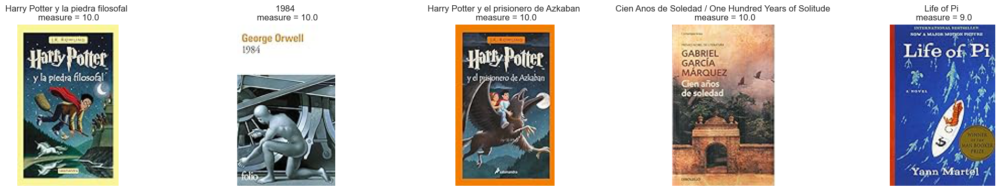

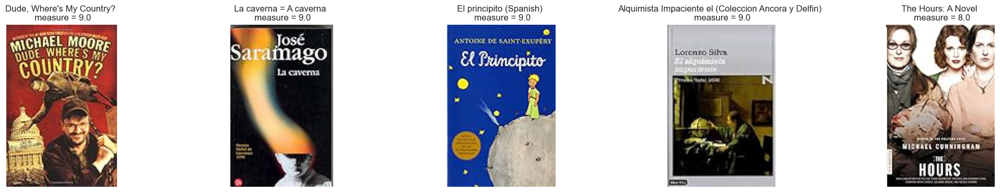

In [29]:
# Пример персонального топа 1
T.top_items("Spain", 15)

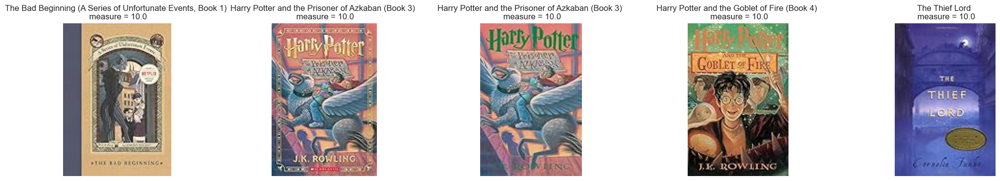

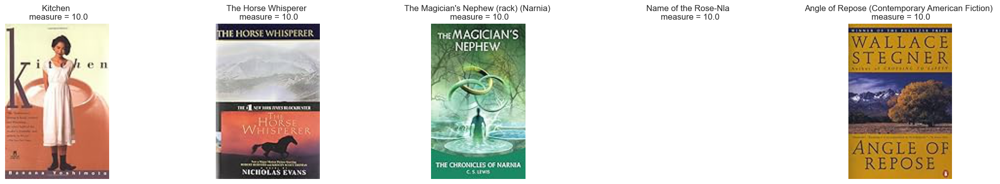

In [30]:
# Пример персонального топа 2
T.top_items("Usa", 10)

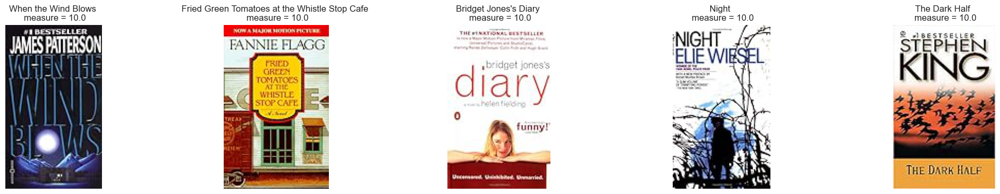

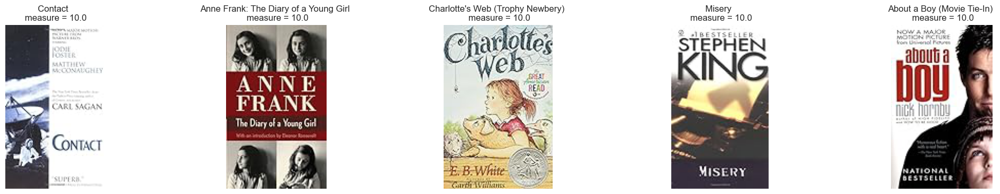

In [31]:
# Пример персонального топа 3
T.top_items("United Kingdom", 45)

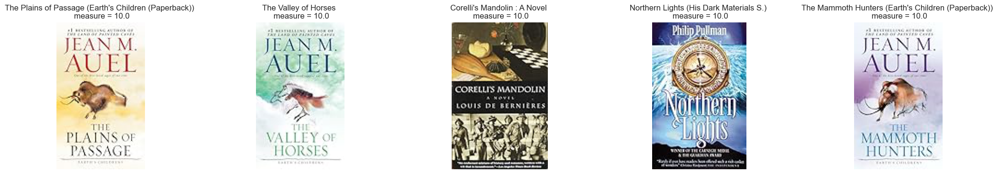

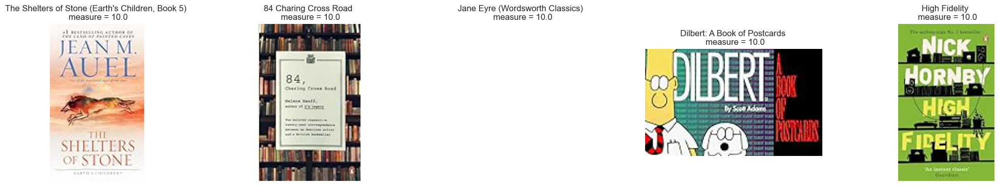

In [32]:
# Пример персонального топа 4
T.top_items("France", 22)

### 2. Кластеризация пользователей

Для кластеризации воспользуемся DBSCAN с косинусным настоянием

In [33]:
csr_rates = coo_matrix(
    (interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])),
    shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))),
)

In [34]:
dbscan = DBSCAN(metric="cosine", eps=0.5, min_samples=10)

In [35]:
users_labels = dbscan.fit_predict(csr_rates)

In [36]:
# Набор данных с id пользователя и меткой кластера, к которому он принадлежит
users_cluster = pd.DataFrame(
    {"vid": list(set(interactions["vid"])), "label": users_labels}
)

In [37]:
users_cluster["label"].value_counts()

label
-1     16512
 0       592
 8       107
 1        32
 27       28
       ...  
 33       10
 14        9
 23        9
 50        9
 40        8
Name: count, Length: 62, dtype: int64

In [38]:
class ClusterTop:
    def __init__(self, ints, users_clusters):
        self.ints = ints
        self.clusters = users_clusters

    def top_items(self, cluster, top_n=10):
        """Функция поиска топа в кластере
        Parameters
        ----------
        cluster
            Номер кластера
        top_n
            Количество рекомендаций
        Returns
        -------
        None
        """

        # Ищем пользователей кластера
        cluster_users = self.clusters[self.clusters["label"] == cluster]["vid"]

        # Ищем книги данных пользователей
        cluster_books = self.ints[self.ints["vid"].isin(cluster_users)]

        # Ищем среди них хорошие
        good_books = cluster_books.groupby("ISBN")["Book-Rating"].mean().reset_index()
        good_books = good_books[good_books["Book-Rating"] >= 7.0].sort_values(
            by=["Book-Rating"], ascending=False
        )

        # Выводим рекомендации
        recommended_books = (
            good_books.merge(
                cluster_books[["ISBN", "Book-Title", "picture_url", "user_num"]],
                on=["ISBN"],
            )
            .drop_duplicates()
            .sort_values(by=["Book-Rating", "user_num"], ascending=False)
            .reset_index(drop=True)
        )
        rec_imaging(recommended_books[:top_n], measure=recommended_books["Book-Rating"])

In [39]:
CT = ClusterTop(interactions, users_cluster)

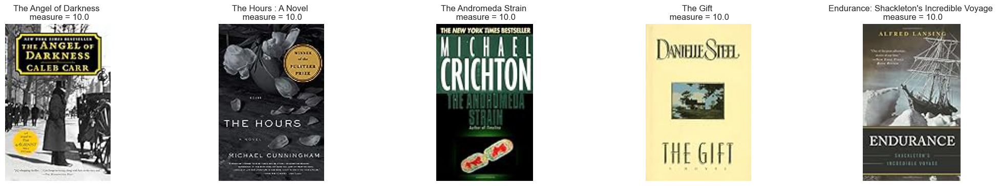

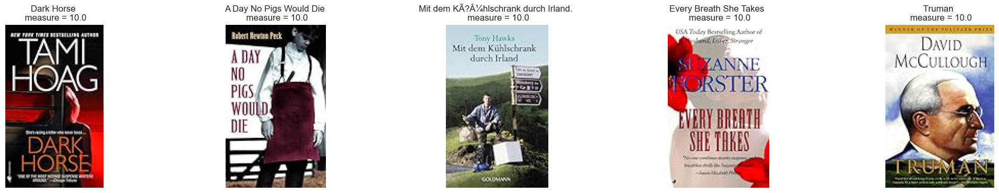

In [40]:
# Пример топа кластера 1
CT.top_items(8)

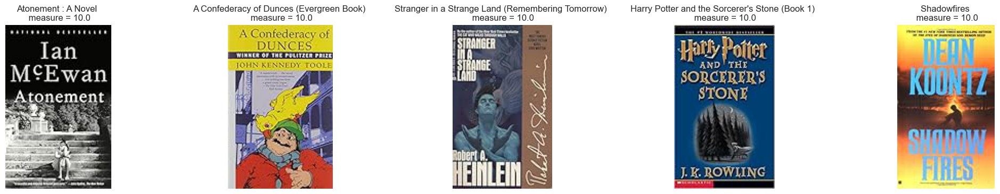

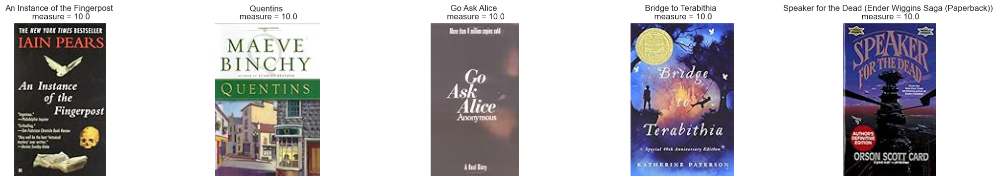

In [41]:
# Пример топа кластера 2
CT.top_items(0)

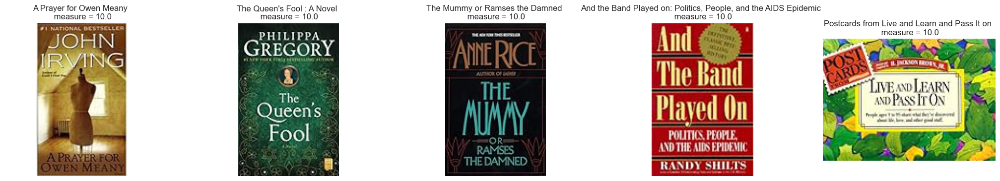

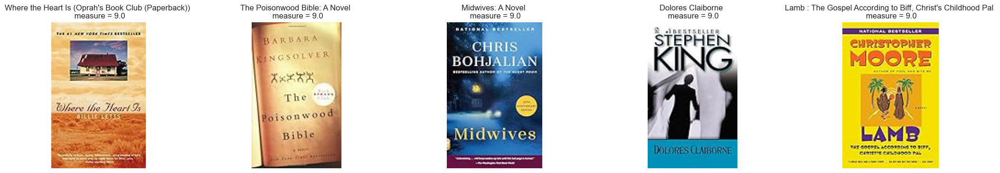

In [42]:
# Пример топа кластера 3
CT.top_items(1)

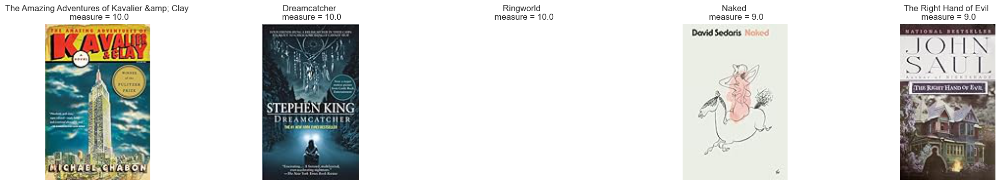

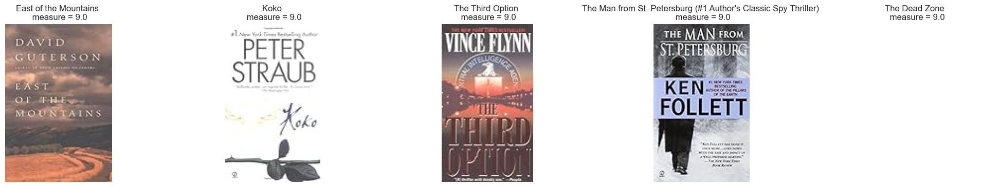

In [43]:
# Пример топа кластера 4
CT.top_items(27)

### 3. Совстречаемость

In [44]:
interactions_tmp = interactions[["vid", "product_id"]].drop_duplicates()

In [46]:
# Таблица со совстречаемыми книгами
user_books = interactions_tmp.groupby(["vid"])["product_id"].apply(list).reset_index()

In [48]:
user_books[:3]

,vid,product_id
0,0,"[0, 8093, 11068, 25386, 29195]"
1,1,"[4480, 11523, 18539, 18725, 23629, 28157, 28161]"
2,2,"[822, 3359, 8916]"


In [237]:
class Recomendations:
    def __init__(self, Int):
        self.interactions = Int

    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()

        # Для каждого пользователя собираем товары, с которыми он взаимодействовал
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()

        # Считаем число товаров, с которыми взаимодействовал каждый пользователь и записываем в колонку prod_num
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num

        # Фильтруем пользователей, взаимодействовавших с одним товаром
        user_products = user_products[user_products["prod_num"] > 1]

        # Заводим словарь под товары и словарь под веса
        cooc = {}
        cooc_weigths = {}

        # Заполнение количества встреч товаров и весов
        # Вес считается как полусумма оценок книг пользователя
        for i in tqdm.notebook.tqdm(user_products.values):
            current_user_rates = self.interactions[self.interactions["vid"] == i[0]][
                ["product_id", "Book-Rating"]
            ]
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                            cooc_weigths[str(i[1][j]) + "_" + str(i[1][k])] += (
                                current_user_rates[
                                    current_user_rates["product_id"] == i[1][j]
                                ]["Book-Rating"].values[0]
                                + current_user_rates[
                                    current_user_rates["product_id"] == i[1][k]
                                ]["Book-Rating"].values[0]
                            ) / 2
                            cooc_weigths[str(i[1][j]) + "_" + str(i[1][k])] /= 2

                        # Ячеек с данным сочетанием книг ещё нет в словарях
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
                            cooc_weigths[str(i[1][j]) + "_" + str(i[1][k])] = (
                                current_user_rates[
                                    current_user_rates["product_id"] == i[1][j]
                                ]["Book-Rating"].values[0]
                                + current_user_rates[
                                    current_user_rates["product_id"] == i[1][k]
                                ]["Book-Rating"].values[0]
                            ) / 2

        # Создание датафрейма со встречами товаров
        cooc_list = []
        for i, j in cooc.items():
            # Если товары встетились вместе больше одного раза и итоговый вес больше нуля, то добавляем в список
            if j != 1 and cooc_weigths[i] > 0:
                cooc_list.append(i.split("_") + [j] + [cooc_weigths[i]])
        self.cooc_rec = pd.DataFrame(
            cooc_list, columns=["item1", "item2", "count", "weight"]
        )
        self.cooc_rec["item1"] = self.cooc_rec["item1"].astype(int)
        self.cooc_rec["item2"] = self.cooc_rec["item2"].astype(int)

        # Мера равняется произведению количества встреч на вес
        self.cooc_rec["measure"] = self.cooc_rec["weight"] * self.cooc_rec["count"]

    def get_rec(self, i):
        """Рекомендация на основе совстречаемости
        Parameters
        ----------
        i
            ID книги
        Returns
        -------
        None
        """
        # Поиск рекомендаций
        recs = (
            self.cooc_rec[self.cooc_rec["item1"] == i]
            .sort_values("measure", ascending=False)
            .head(10)
        )

        # Поиск данных о книге для искомой книги
        item1_book_data = self.interactions[self.interactions["product_id"] == i][
            ["product_id", "Book-Title", "picture_url"]
        ].drop_duplicates()

        # Поиск данных о книгах в рекомендациях
        items2_book_data = self.interactions[
            self.interactions["product_id"].isin(recs["item2"])
        ][["product_id", "Book-Title", "picture_url"]].drop_duplicates()

        # Сортировка данных о книгах в соответствии с мерой
        items2_book_data = items2_book_data.merge(
            recs[["item2", "measure"]], left_on="product_id", right_on="item2"
        ).sort_values("measure", ascending=False)
        items2_book_data = items2_book_data.drop(columns=["item2", "measure"])

        # Вывод рекомендаций
        print("Для товара")
        rec_imaging(item1_book_data)
        print("Такие рекомендации")
        rec_imaging(items2_book_data, recs["measure"].values)

In [244]:
cooc_rec = Recomendations(interactions)
cooc_rec.coocurrency_count()

  0%|          | 0/17030 [00:00<?, ?it/s]

In [245]:
# Таблица совстречаемости
cooc_rec.cooc_rec.sort_values("measure", ascending=False).head()

,item1,item2,count,weight,measure
12710,19904,12349,65,9.230328,599.971294
12260,12349,19904,65,9.230328,599.971294
11470,12395,12391,59,9.744109,574.902419
11448,12391,12395,59,9.744109,574.902419
11426,12349,12391,62,9.259332,574.078561


Для товара


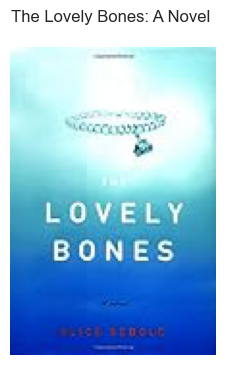

Такие рекомендации


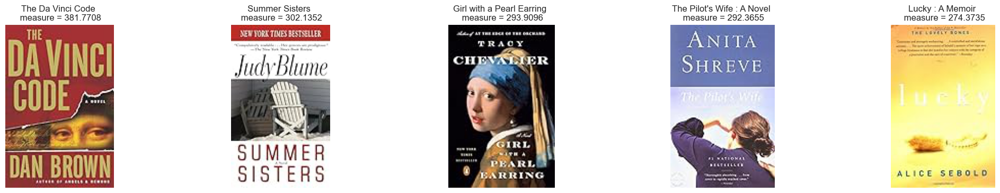

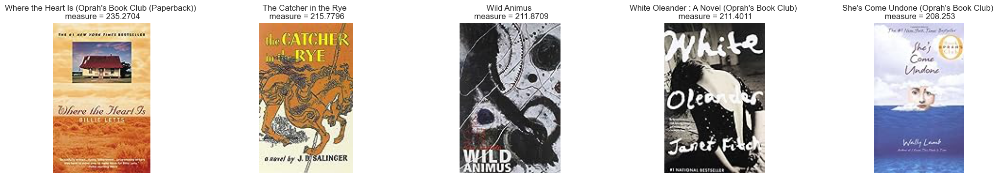

In [246]:
# Пример рекомендаций по совстречаемости 1
cooc_rec.get_rec(4813)

Для товара


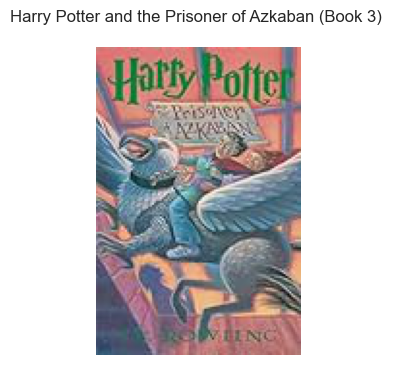

Такие рекомендации


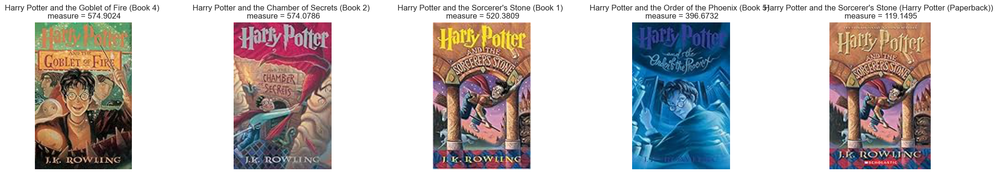

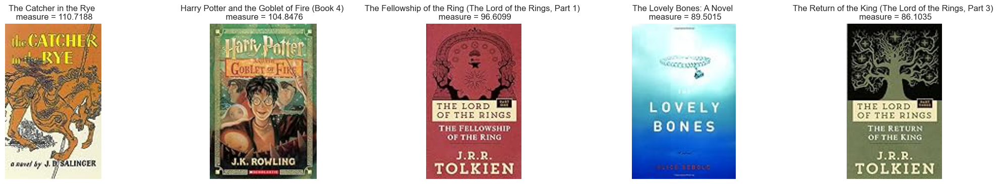

In [247]:
# Пример рекомендаций по совстречаемости 2
cooc_rec.get_rec(12391)

Для товара


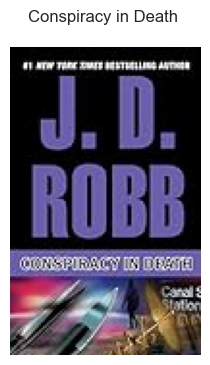

Такие рекомендации


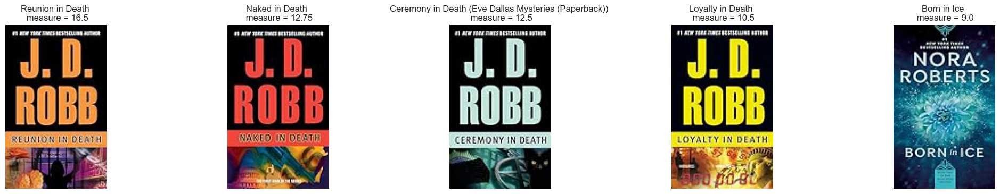

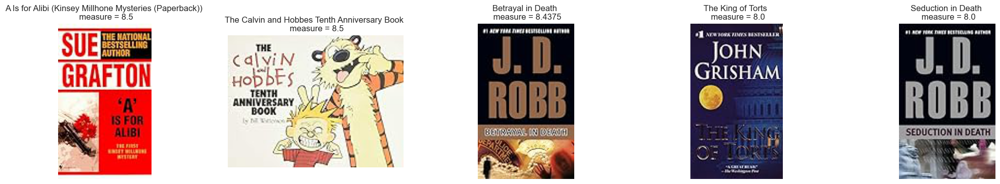

In [251]:
# Пример рекомендаций по совстречаемости 3
cooc_rec.get_rec(11930)

### 4. Коллаборативная фильтрация

In [346]:
class Collaborative:
    def __init__(self, interactions):
        self.interactions = interactions
        self.csr_rates = coo_matrix(
            (
                interactions["Book-Rating"],
                (interactions["vid"], interactions["product_id"]),
            ),
            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))),
        )

    def get_rec(self, i, user_based=True, top_n=10):
        """Рекомендация на основе коллаборативной фильтрации
        Parameters
        ----------
        i
            ID пользователя/книги
        user_based
            Тип (user based при True, item based при False)
        top_n
            Количество рекомендаций
        Returns
        -------
        None
        """
        
        # Поиск нужных значений и расчёт меры схожести
        if user_based:
            rates = self.csr_rates.getrow(i).toarray()[0]
            similarity_score = cosine_similarity([rates], self.csr_rates).reshape(-1, 1)
        else:
            rates = self.csr_rates.getcol(i).toarray().reshape(1, -1)
            self.csr_rates = self.csr_rates.T
            similarity_score = cosine_similarity(rates, self.csr_rates).reshape(-1, 1)

        # Расчёт итоговой метрики
        result_score = csr_matrix.multiply(self.csr_rates.copy(), similarity_score)

        if user_based:
            measure = (1 - rates.astype(bool)) * np.array(np.sum(result_score, axis=0))[0]
            initial_items = np.where(rates != 0)[0] # Книги пользователя
        else:
            measure = np.array(np.sum(result_score, axis=1)).ravel()
            initial_items = [i] # Исходная книга
            self.csr_rates = self.csr_rates.T

        # Список рекомендуемых книг
        recommended_items = np.arange(self.csr_rates.shape[1])[
            np.argsort(measure)[::-1][:top_n]
        ]
        # Меры схожести рекомендуемых книг 
        recommended_items_measure = np.sort(measure)[::-1][:top_n]
        
        # Датафрейм с рекомендациями
        recs = pd.DataFrame(
            {"item": recommended_items, "measure": recommended_items_measure}
        )
        
        # Данные об исходных книгах
        items1_book_data = (
            self.interactions[self.interactions["product_id"].isin(initial_items)][
                ["Book-Title", "picture_url"]
            ]
            .drop_duplicates()
            .reset_index(drop=True)
        )

        # Поиск данных о книгах в рекомендациях
        items2_book_data = self.interactions[
            self.interactions["product_id"].isin(recs["item"])
        ][["product_id", "Book-Title", "picture_url"]].drop_duplicates()

        # Сортировка данных о книгах в соответствии с мерой
        items2_book_data = items2_book_data.merge(
            recs[["item", "measure"]], left_on="product_id", right_on="item"
        ).sort_values("measure", ascending=False)
        items2_book_data = items2_book_data.drop(columns=["item", "measure"])
        
        
        print(f"Для {'пользователя ' + str(i) if user_based else 'товара'}")
        rec_imaging(items1_book_data)
        print("Такие рекомендации")
        rec_imaging(items2_book_data, recs["measure"].values)

In [347]:
clb = Collaborative(interactions)

Для пользователя 69


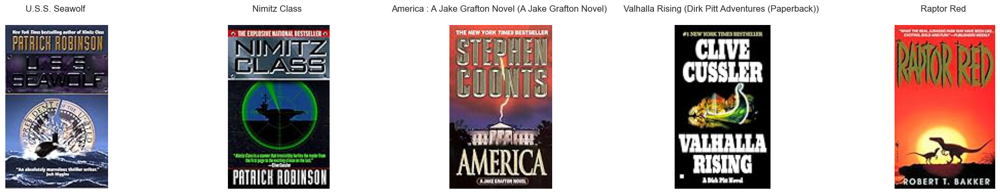

Такие рекомендации


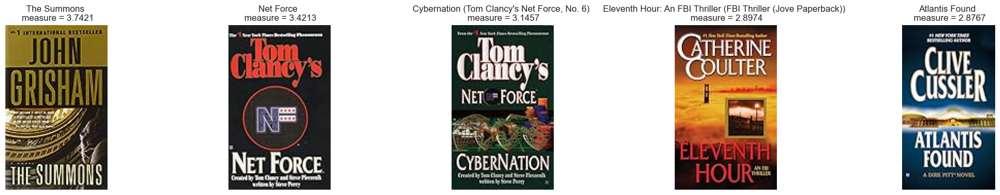

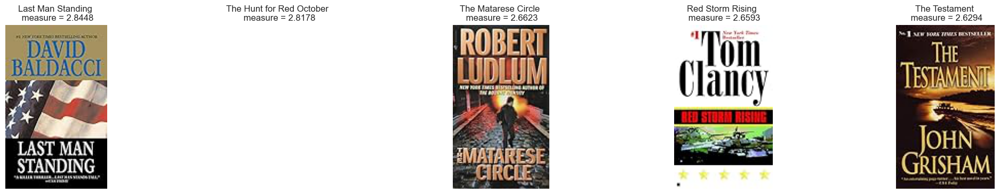

In [351]:
# Пример user-based рекомендации 1
clb.get_rec(69, user_based=True)

Для пользователя 1337


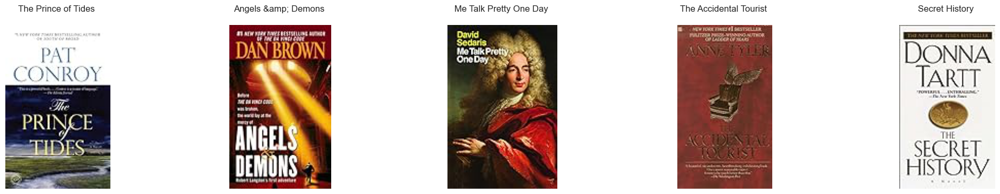

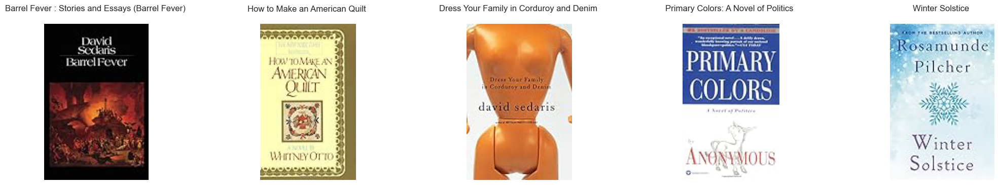

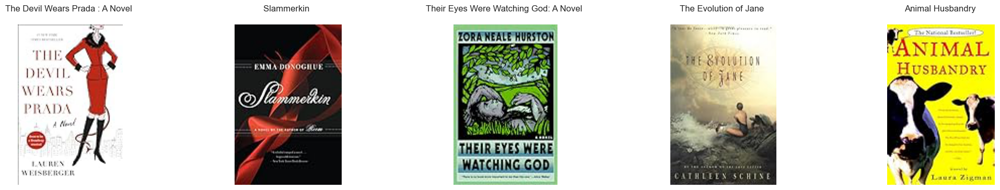

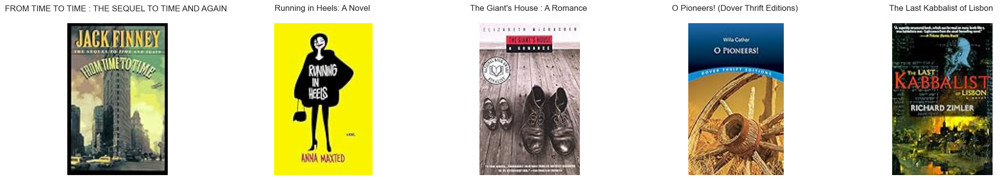

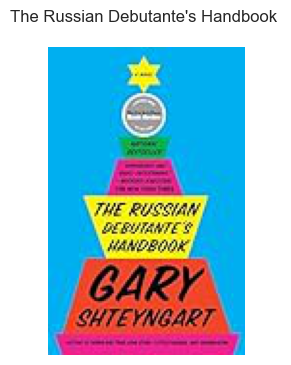

Такие рекомендации


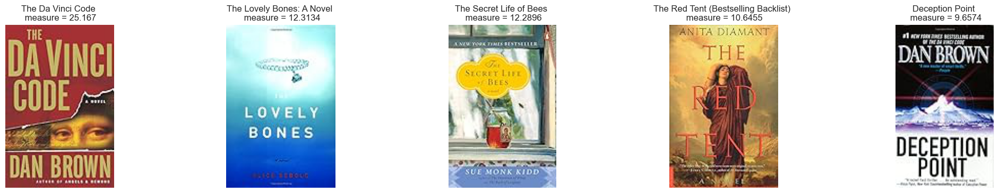

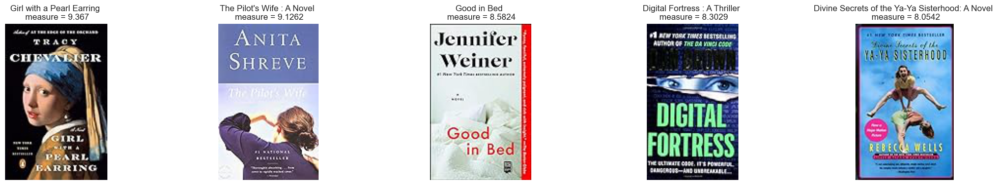

In [352]:
# Пример user-based рекомендации 2
clb.get_rec(1337, user_based=True)

Для товара


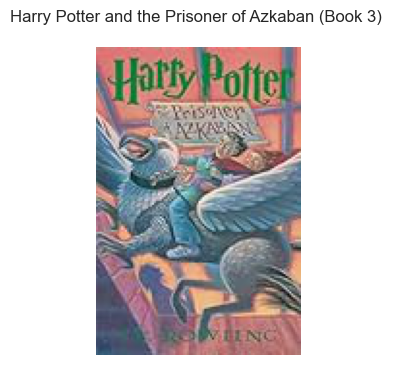

Такие рекомендации


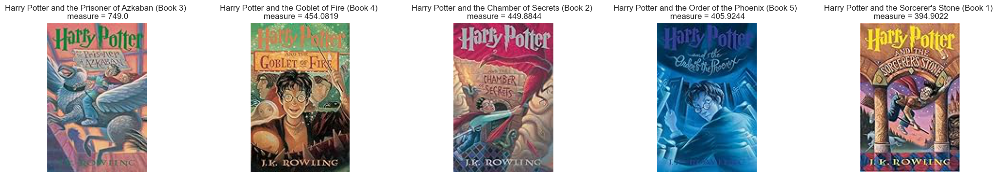

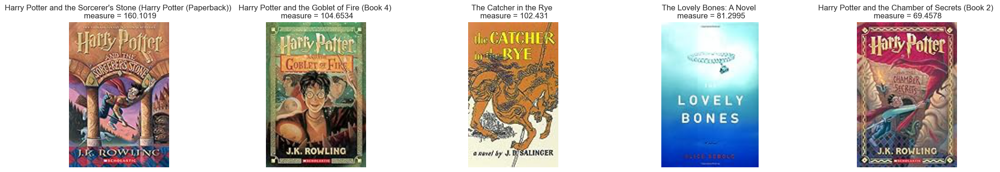

In [350]:
# Пример item-based рекомендации 1
clb.get_rec(12391, user_based=False)

Для товара


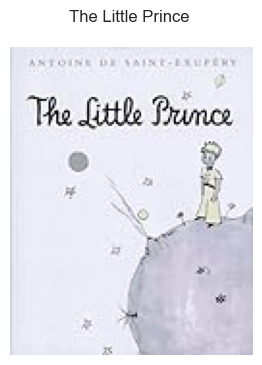

Такие рекомендации


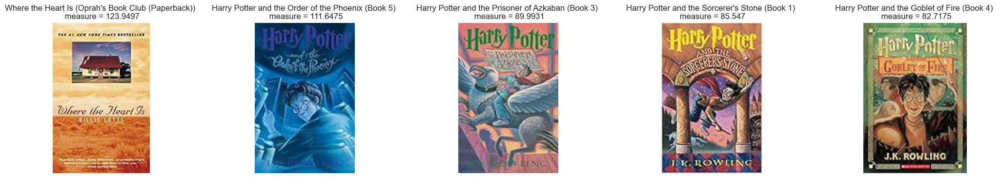

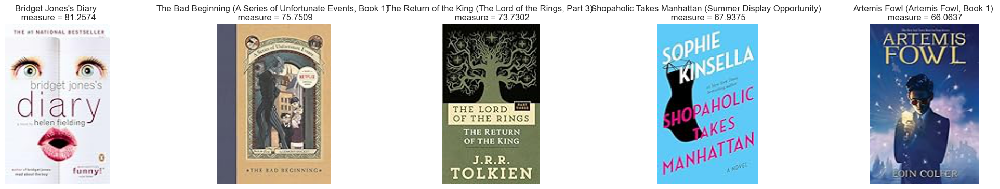

In [354]:
# Пример item-based рекомендации 2
clb.get_rec(3275, user_based=False)

Коллаборативная фильтрация даёт схожие результаты с методом совстречаемости, однако её обучение гораздо быстрее.

## Итоги по работе

Рекомендательные системы очень интересная тема, но довольно комплексная. Также в процессе выполнения данной я подметил много интересных книг.